# Imports :

In [ ]:
import nltk
nltk.download("punkt")
nltk.download("punkt_tab")
nltk.download("stopwords")

In [16]:
import pandas as pd
import numpy as np
import pickle
from difflib import get_close_matches,SequenceMatcher
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from surprise import SVD, Dataset, Reader
import matplotlib.pyplot as plt
import re
from wordcloud import WordCloud 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import ast

# Reading Dataframe :

In [19]:
df1 = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/credits.csv")
df2 = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/keywords.csv" )
df3 = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/movies_metadata.csv" )
ratings = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/ratings.csv")
links = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/links.csv")

<>:1: SyntaxWarning: invalid escape sequence '\M'
<>:2: SyntaxWarning: invalid escape sequence '\M'
<>:3: SyntaxWarning: invalid escape sequence '\M'
<>:4: SyntaxWarning: invalid escape sequence '\M'
<>:5: SyntaxWarning: invalid escape sequence '\M'
<>:1: SyntaxWarning: invalid escape sequence '\M'
<>:2: SyntaxWarning: invalid escape sequence '\M'
<>:3: SyntaxWarning: invalid escape sequence '\M'
<>:4: SyntaxWarning: invalid escape sequence '\M'
<>:5: SyntaxWarning: invalid escape sequence '\M'
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\240194262.py:1: SyntaxWarning: invalid escape sequence '\M'
  df1 = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/credits.csv")
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\240194262.py:2: SyntaxWarning: invalid escape sequence '\M'
  df2 = pd.read_csv("D:\Models\Recommender System\Recommendation System( The Movies )/keywords.csv" )
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\240194262.py:3: SyntaxWar

In [20]:
df1

,cast,crew,id
0,"[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de...",862
1,"[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de...",8844
2,"[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de...",15602
3,"[{'cast_id': 1, 'character': ""Savannah 'Vannah...","[{'credit_id': '52fe44779251416c91011acb', 'de...",31357
4,"[{'cast_id': 1, 'character': 'George Banks', '...","[{'credit_id': '52fe44959251416c75039ed7', 'de...",11862
...,...,...,...
45471,"[{'cast_id': 0, 'character': '', 'credit_id': ...","[{'credit_id': '5894a97d925141426c00818c', 'de...",439050
45472,"[{'cast_id': 1002, 'character': 'Sister Angela...","[{'credit_id': '52fe4af1c3a36847f81e9b15', 'de...",111109
45473,"[{'cast_id': 6, 'character': 'Emily Shaw', 'cr...","[{'credit_id': '52fe4776c3a368484e0c8387', 'de...",67758
45474,"[{'cast_id': 2, 'character': '', 'credit_id': ...","[{'credit_id': '533bccebc3a36844cf0011a7', 'de...",227506


In [21]:
df2

,id,keywords
0,862,"[{'id': 931, 'name': 'jealousy'}, {'id': 4290,..."
1,8844,"[{'id': 10090, 'name': 'board game'}, {'id': 1..."
2,15602,"[{'id': 1495, 'name': 'fishing'}, {'id': 12392..."
3,31357,"[{'id': 818, 'name': 'based on novel'}, {'id':..."
4,11862,"[{'id': 1009, 'name': 'baby'}, {'id': 1599, 'n..."
...,...,...
46414,439050,"[{'id': 10703, 'name': 'tragic love'}]"
46415,111109,"[{'id': 2679, 'name': 'artist'}, {'id': 14531,..."
46416,67758,[]
46417,227506,[]


In [22]:
df3

,adult,belongs_to_collection,budget,genres,homepage,id,imdb_id,original_language,original_title,overview,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
0,False,"{'id': 10194, 'name': 'Toy Story Collection', ...",30000000,"[{'id': 16, 'name': 'Animation'}, {'id': 35, '...",http://toystory.disney.com/toy-story,862,tt0114709,en,Toy Story,"Led by Woody, Andy's toys live happily in his ...",...,1995-10-30,373554033.0,81.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Toy Story,False,7.7,5415.0
1,False,NaN,65000000,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",NaN,8844,tt0113497,en,Jumanji,When siblings Judy and Peter discover an encha...,...,1995-12-15,262797249.0,104.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,Roll the dice and unleash the excitement!,Jumanji,False,6.9,2413.0
2,False,"{'id': 119050, 'name': 'Grumpy Old Men Collect...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...",NaN,15602,tt0113228,en,Grumpier Old Men,A family wedding reignites the ancient feud be...,...,1995-12-22,0.0,101.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Still Yelling. Still Fighting. Still Ready for...,Grumpier Old Men,False,6.5,92.0
3,False,NaN,16000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,31357,tt0114885,en,Waiting to Exhale,"Cheated on, mistreated and stepped on, the wom...",...,1995-12-22,81452156.0,127.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Friends are the people who let you be yourself...,Waiting to Exhale,False,6.1,34.0
4,False,"{'id': 96871, 'name': 'Father of the Bride Col...",0,"[{'id': 35, 'name': 'Comedy'}]",NaN,11862,tt0113041,en,Father of the Bride Part II,Just when George Banks has recovered from his ...,...,1995-02-10,76578911.0,106.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Just When His World Is Back To Normal... He's ...,Father of the Bride Part II,False,5.7,173.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45461,False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10751, 'n...",http://www.imdb.com/title/tt6209470/,439050,tt6209470,fa,رگ خواب,Rising and falling between a man and woman.,...,NaN,0.0,90.0,"[{'iso_639_1': 'fa', 'name': 'فارسی'}]",Released,Rising and falling between a man and woman,Subdue,False,4.0,1.0
45462,False,NaN,0,"[{'id': 18, 'name': 'Drama'}]",NaN,111109,tt2028550,tl,Siglo ng Pagluluwal,An artist struggles to finish his work while a...,...,2011-11-17,0.0,360.0,"[{'iso_639_1': 'tl', 'name': ''}]",Released,NaN,Century of Birthing,False,9.0,3.0
45463,False,NaN,0,"[{'id': 28, 'name': 'Action'}, {'id': 18, 'nam...",NaN,67758,tt0303758,en,Betrayal,"When one of her hits goes wrong, a professiona...",...,2003-08-01,0.0,90.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,A deadly game of wits.,Betrayal,False,3.8,6.0
45464,False,NaN,0,[],NaN,227506,tt0008536,en,Satana likuyushchiy,"In a small town live two brothers, one a minis...",...,1917-10-21,0.0,87.0,[],Released,NaN,Satan Triumphant,False,0.0,0.0


In [23]:
ratings

,userId,movieId,rating,timestamp
0,1,110,1.0,1425941529
1,1,147,4.5,1425942435
2,1,858,5.0,1425941523
3,1,1221,5.0,1425941546
4,1,1246,5.0,1425941556
...,...,...,...,...
26024284,270896,58559,5.0,1257031564
26024285,270896,60069,5.0,1257032032
26024286,270896,63082,4.5,1257031764
26024287,270896,64957,4.5,1257033990


# Merging Dataframes :

In [30]:
links.dtypes

movieId      int64
imdbId       int64
tmdbId     float64
dtype: object

In [32]:
links.isna().sum()

movieId      0
imdbId       0
tmdbId     219
dtype: int64

In [34]:
links.dropna(inplace=True)
links.isna().sum()

movieId    0
imdbId     0
tmdbId     0
dtype: int64

In [36]:
links['tmdbId'] = links['tmdbId'].astype(int)

In [38]:
# in linkss dataframe there are IDs that are the same as df so we merge tmdbId in links with MovieId in ratings so 
# when we need to search in df about a film we have the same id in the df which is tmdbId 
ratings = ratings.merge(links[['movieId', 'tmdbId']], on='movieId')
ratings = ratings.rename(columns={'tmdbId': 'id'})

In [39]:
df1['id'] = pd.to_numeric(df1['id'], errors="coerce")
df2['id'] = pd.to_numeric(df2['id'], errors="coerce")
df3['id'] = pd.to_numeric(df3['id'], errors="coerce")

df1 = df1.dropna(subset=['id'])
df2 = df2.dropna(subset=['id'])
df3 = df3.dropna(subset=['id'])

# دلوقتي ادمج وأنت مطمن إنهم أرقام زي بعض
df = df1.merge(df2, how="left", on="id").merge(df3, how="left", on="id")
df

,cast,crew,id,keywords,adult,belongs_to_collection,budget,genres,homepage,imdb_id,...,release_date,revenue,runtime,spoken_languages,status,tagline,title,video,vote_average,vote_count
0,"[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de...",862,"[{'id': 931, 'name': 'jealousy'}, {'id': 4290,...",False,"{'id': 10194, 'name': 'Toy Story Collection', ...",30000000,"[{'id': 16, 'name': 'Animation'}, {'id': 35, '...",http://toystory.disney.com/toy-story,tt0114709,...,1995-10-30,373554033.0,81.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,NaN,Toy Story,False,7.7,5415.0
1,"[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de...",8844,"[{'id': 10090, 'name': 'board game'}, {'id': 1...",False,NaN,65000000,"[{'id': 12, 'name': 'Adventure'}, {'id': 14, '...",NaN,tt0113497,...,1995-12-15,262797249.0,104.0,"[{'iso_639_1': 'en', 'name': 'English'}, {'iso...",Released,Roll the dice and unleash the excitement!,Jumanji,False,6.9,2413.0
2,"[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de...",15602,"[{'id': 1495, 'name': 'fishing'}, {'id': 12392...",False,"{'id': 119050, 'name': 'Grumpy Old Men Collect...",0,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...",NaN,tt0113228,...,1995-12-22,0.0,101.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Still Yelling. Still Fighting. Still Ready for...,Grumpier Old Men,False,6.5,92.0
3,"[{'cast_id': 1, 'character': ""Savannah 'Vannah...","[{'credit_id': '52fe44779251416c91011acb', 'de...",31357,"[{'id': 818, 'name': 'based on novel'}, {'id':...",False,NaN,16000000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",NaN,tt0114885,...,1995-12-22,81452156.0,127.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Friends are the people who let you be yourself...,Waiting to Exhale,False,6.1,34.0
4,"[{'cast_id': 1, 'character': 'George Banks', '...","[{'credit_id': '52fe44959251416c75039ed7', 'de...",11862,"[{'id': 1009, 'name': 'baby'}, {'id': 1599, 'n...",False,"{'id': 96871, 'name': 'Father of the Bride Col...",0,"[{'id': 35, 'name': 'Comedy'}]",NaN,tt0113041,...,1995-02-10,76578911.0,106.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,Just When His World Is Back To Normal... He's ...,Father of the Bride Part II,False,5.7,173.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46623,"[{'cast_id': 0, 'character': '', 'credit_id': ...","[{'credit_id': '5894a97d925141426c00818c', 'de...",439050,"[{'id': 10703, 'name': 'tragic love'}]",False,NaN,0,"[{'id': 18, 'name': 'Drama'}, {'id': 10751, 'n...",http://www.imdb.com/title/tt6209470/,tt6209470,...,NaN,0.0,90.0,"[{'iso_639_1': 'fa', 'name': 'فارسی'}]",Released,Rising and falling between a man and woman,Subdue,False,4.0,1.0
46624,"[{'cast_id': 1002, 'character': 'Sister Angela...","[{'credit_id': '52fe4af1c3a36847f81e9b15', 'de...",111109,"[{'id': 2679, 'name': 'artist'}, {'id': 14531,...",False,NaN,0,"[{'id': 18, 'name': 'Drama'}]",NaN,tt2028550,...,2011-11-17,0.0,360.0,"[{'iso_639_1': 'tl', 'name': ''}]",Released,NaN,Century of Birthing,False,9.0,3.0
46625,"[{'cast_id': 6, 'character': 'Emily Shaw', 'cr...","[{'credit_id': '52fe4776c3a368484e0c8387', 'de...",67758,[],False,NaN,0,"[{'id': 28, 'name': 'Action'}, {'id': 18, 'nam...",NaN,tt0303758,...,2003-08-01,0.0,90.0,"[{'iso_639_1': 'en', 'name': 'English'}]",Released,A deadly game of wits.,Betrayal,False,3.8,6.0
46626,"[{'cast_id': 2, 'character': '', 'credit_id': ...","[{'credit_id': '533bccebc3a36844cf0011a7', 'de...",227506,[],False,NaN,0,[],NaN,tt0008536,...,1917-10-21,0.0,87.0,[],Released,NaN,Satan Triumphant,False,0.0,0.0


In [40]:
df.columns

Index(['cast', 'crew', 'id', 'keywords', 'adult', 'belongs_to_collection',
       'budget', 'genres', 'homepage', 'imdb_id', 'original_language',
       'original_title', 'overview', 'popularity', 'poster_path',
       'production_companies', 'production_countries', 'release_date',
       'revenue', 'runtime', 'spoken_languages', 'status', 'tagline', 'title',
       'video', 'vote_average', 'vote_count'],
      dtype='object')

# Data Preprocessing :

In [43]:
df.isna().sum()

cast                         0
crew                         0
id                           0
keywords                     0
adult                        0
belongs_to_collection    42054
budget                       0
genres                       0
homepage                 38619
imdb_id                     17
original_language           11
original_title               0
overview                   995
popularity                   4
poster_path                399
production_companies         4
production_countries         4
release_date                88
revenue                      4
runtime                    268
spoken_languages             4
status                      86
tagline                  25845
title                        4
video                        4
vote_average                 4
vote_count                   4
dtype: int64

In [47]:
df.dtypes

cast                      object
crew                      object
id                         int64
keywords                  object
adult                     object
belongs_to_collection     object
budget                    object
genres                    object
homepage                  object
imdb_id                   object
original_language         object
original_title            object
overview                  object
popularity                object
poster_path               object
production_companies      object
production_countries      object
release_date              object
revenue                  float64
runtime                  float64
spoken_languages          object
status                    object
tagline                   object
title                     object
video                     object
vote_average             float64
vote_count               float64
dtype: object

## Selecting The Most Important Columns :

In [50]:
df = df[df['vote_count'] > 30] 
selected_columns = ['cast', 'genres','keywords','title','overview']
# its recommended in NLP and recommenders to fill null vaules with ""
for col in selected_columns:
    df[col] = df[col].fillna("")

df.isna().sum()

C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\311237811.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[col] = df[col].fillna("")


cast                        0
crew                        0
id                          0
keywords                    0
adult                       0
belongs_to_collection    9945
budget                      0
genres                      0
homepage                 8982
imdb_id                     2
original_language           0
original_title              0
overview                    0
popularity                  0
poster_path                 0
production_companies        0
production_countries        0
release_date                2
revenue                     0
runtime                     5
spoken_languages            0
status                      1
tagline                  3503
title                       0
video                       0
vote_average                0
vote_count                  0
dtype: int64

In [52]:
print(df.duplicated().sum())
print(df['title'].duplicated().sum())

197
645


In [53]:
df["title"].value_counts()

title
The Congress                                   8
Le Samouraï                                    8
Force Majeure                                  8
Pokémon: Spell of the Unknown                  8
Pokémon 4Ever: Celebi - Voice of the Forest    8
                                              ..
Ride the High Country                          1
The Ballad of Cable Hogue                      1
The Haunted Palace                             1
Drunken Angel                                  1
Cadet Kelly                                    1
Name: count, Length: 11734, dtype: int64

In [56]:
df.drop_duplicates(inplace=True)
df.drop_duplicates(subset="title", inplace=True)
df.reset_index(drop=True, inplace=True)

print(df.duplicated().sum())
print(df['title'].duplicated().sum())

C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\1958910944.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(inplace=True)
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\1958910944.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(subset="title", inplace=True)


0
0


In [58]:
def extract_names(column_data):
    try:
        # بيحول النص لشكل قائمة حقيقية
        data = ast.literal_eval(column_data)
        # بياخد الـ name بس (زي اسم الممثل أو نوع الفيلم)
        return " ".join([i['name'] for i in data])
    except:
        return ""
        
df['cast'] = df['cast'].apply(extract_names)
df['genres'] = df['genres'].apply(extract_names)
df['keywords'] = df['keywords'].apply(extract_names)

C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\926918414.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['cast'] = df['cast'].apply(extract_names)
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\926918414.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['genres'] = df['genres'].apply(extract_names)
C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\926918414.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

In [60]:
df['keywords'][483]

'italy love at first sight loss of father patriarch organized crime mafia lawyer italian american crime family rise to power mob boss 1940s'

In [62]:
df['overview'][483]

'Spanning the years 1945 to 1955, a chronicle of the fictional Italian-American Corleone crime family. When organized crime family patriarch, Vito Corleone barely survives an attempt on his life, his youngest son, Michael steps in to take care of the would-be killers, launching a campaign of bloody revenge.'

In [64]:
df['cast'][483]

'Marlon Brando Al Pacino James Caan Richard S. Castellano Robert Duvall Sterling Hayden John Marley Richard Conte Al Lettieri Diane Keaton Abe Vigoda Talia Shire Gianni Russo John Cazale Rudy Bond Al Martino Morgana King Lenny Montana John Martino Salvatore Corsitto Alex Rocco Tony Giorgio Victor Rendina Simonetta Stefanelli Saro Urzì Sofia Coppola Louis Guss Gabriele Torrei Tony King Richard Bright Vito Scotti Tere Livrano Julie Gregg Angelo Infanti Corrado Gaipa Franco Citti Max Brandt Carmine Coppola Roman Coppola Don Costello Robert Dahdah Gray Frederickson Ron Gilbert Joe Lo Grippo Sonny Grosso Randy Jurgensen Tony Lip Lou Martini Jr. Raymond Martino Joseph Medaglia Rick Petrucelli Sal Richards Tom Rosqui Frank Sivero Filomena Spagnuolo Joe Spinell Nick Vallelonga Conrad Yama'

In [66]:
df['overview'][2480]

'After getting a green card in exchange for assassinating a Cuban government official, Tony Montana stakes a claim on the drug trade in Miami. Viciously murdering anyone who stands in his way, Tony eventually becomes the biggest drug lord in the state, controlling nearly all the cocaine that comes through Miami. But increased pressure from the police, wars with Colombian drug cartels and his own drug-fueled paranoia serve to fuel the flames of his eventual downfall.'

In [68]:
# فاحنا بنحط السلاش \ عشان نقول لبايثون: "يا بايثون، الأمر لسه مخلصش، كمل قراءة السطر اللي جاي كأنه جزء من السطر ده."
df['combined_text'] = (df['genres'] + " ") * 5 + \
                      (df['cast'] + " ") * 3 + \
                      (df['keywords'] + " ") * 5 + \
                      (df['title'] + " ") * 1 + \
                      (df['overview'] + " ") * 2

C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\4262912658.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['combined_text'] = (df['genres'] + " ") * 5 + \


## Transforming Selected Columns into one Column :

In [71]:
# astype(str) ---> converts nan and numeric values to string
# agg ---> grouping the series to one series
combined_text = ' '.join(df['combined_text'])
combined_text

'Animation Comedy Family Animation Comedy Family Animation Comedy Family Animation Comedy Family Animation Comedy Family Tom Hanks Tim Allen Don Rickles Jim Varney Wallace Shawn John Ratzenberger Annie Potts John Morris Erik von Detten Laurie Metcalf R. Lee Ermey Sarah Freeman Penn Jillette Tom Hanks Tim Allen Don Rickles Jim Varney Wallace Shawn John Ratzenberger Annie Potts John Morris Erik von Detten Laurie Metcalf R. Lee Ermey Sarah Freeman Penn Jillette Tom Hanks Tim Allen Don Rickles Jim Varney Wallace Shawn John Ratzenberger Annie Potts John Morris Erik von Detten Laurie Metcalf R. Lee Ermey Sarah Freeman Penn Jillette jealousy toy boy friendship friends rivalry boy next door new toy toy comes to life jealousy toy boy friendship friends rivalry boy next door new toy toy comes to life jealousy toy boy friendship friends rivalry boy next door new toy toy comes to life jealousy toy boy friendship friends rivalry boy next door new toy toy comes to life jealousy toy boy friendship fr

In [72]:
df['combined_text']

0        Animation Comedy Family Animation Comedy Famil...
1        Adventure Fantasy Family Adventure Fantasy Fam...
2        Romance Comedy Romance Comedy Romance Comedy R...
3        Comedy Drama Romance Comedy Drama Romance Come...
4        Comedy Comedy Comedy Comedy Comedy Steve Marti...
                               ...                        
11729    Horror Science Fiction Horror Science Fiction ...
11730    Comedy Crime Comedy Crime Comedy Crime Comedy ...
11731    Romance Comedy Romance Comedy Romance Comedy R...
11732    Family Animation Romance Comedy Family Animati...
11733    Comedy Comedy Comedy Comedy Comedy Hilary Duff...
Name: combined_text, Length: 11734, dtype: object

In [75]:
def Text_Preprocessing(text):
    text = re.sub(r"[^A-Za-z0-9\s]",'',text)
    return text

df["combined_text"] = df["combined_text"].apply(Text_Preprocessing)

C:\Users\muhaned\AppData\Local\Temp\ipykernel_3980\3668191157.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["combined_text"] = df["combined_text"].apply(Text_Preprocessing)


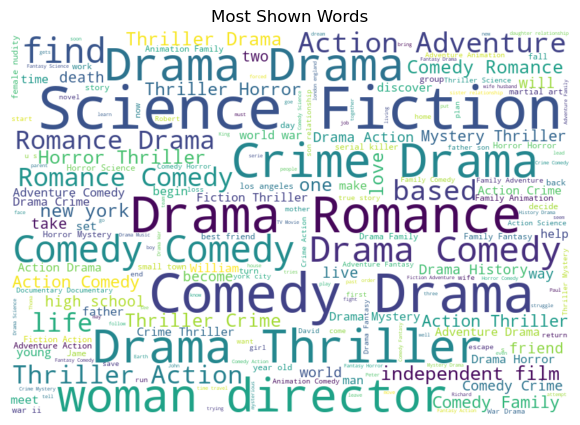

In [77]:
# making sure that the top words in garbage words are deleted 
# we cannot use replace without loop because its not a series because pandas cannot take it as an input list 
# for word in garbage_words:
#    combined_text = combined_text.replace(word, "")

wordcloud = WordCloud(height=550 , width=800 , background_color="white").generate(combined_text)

plt.figure(figsize=(10,5))
plt.imshow(wordcloud,interpolation = "bilinear")
plt.axis("off")
plt.title("Most Shown Words")
plt.show()

In [78]:
print(df.shape) 
print(df['combined_text'].shape)

(11734, 28)
(11734,)


In [81]:
with open('Cleaned_df.pkl','wb') as f: 
    pickle.dump(df,f)

# Recommendations :

## Similarity Calculation :

In [85]:
def calc_cosine_sim():
# Converts the text into numeric data
    vec = TfidfVectorizer(stop_words='english', min_df=2)
    Frequency = vec.fit_transform(df['combined_text'])
    sim = cosine_similarity(Frequency)
    
    with open('movies_similarity.pkl','wb') as f:
        pickle.dump(sim,f)

In [87]:
calc_cosine_sim()

In [88]:
def Recommendation(Movie_name, with_scores=True, top_n=50):
    Movies_list = df["title"].to_list()
    try:
        with open('movies_similarity.pkl', 'rb') as f:
            sim = pickle.load(f)
    except FileNotFoundError:
        calc_cosine_sim()
        with open('movies_similarity.pkl', 'rb') as f:
            sim = pickle.load(f) # نستخدم load مش dump

    find_close_match = get_close_matches(Movie_name, Movies_list)

    if not find_close_match:
        print(f"Movie '{Movie_name}' not found. Please try another movie!")
        return []

    closest = find_close_match[0]
    similarity_ratio = SequenceMatcher(None, Movie_name.lower(), closest.lower()).ratio()

    if similarity_ratio < 0.7:
        print("Movie not similar enough, please enter another movie!")
        return []

    print(f"Selected Movie: {closest}")

    index_of_the_movie = df[df.title == closest].index[0]
    similarity_score = list(enumerate(sim[index_of_the_movie]))
    sorted_similar_movies = sorted(similarity_score, key=lambda x: x[1], reverse=True)

    suggested_movies = []
    i = 0
    for index, score in sorted_similar_movies:
        title_from_index = df.iloc[index]['title']

        if title_from_index != closest:
            if with_scores:
                suggested_movies.append((title_from_index, score))
            else:
                suggested_movies.append(title_from_index)
            i += 1
        if i >= top_n:
            break

    return suggested_movies if with_scores else [r[0] for r in suggested_movies]


In [89]:
Recommendation('the godfather')

Selected Movie: The Godfather


[('The Godfather: Part II', 0.35766077495466336),
 ('The Godfather: Part III', 0.27756410979136853),
 ('Mr. Majestyk', 0.14725283015529497),
 ('Innocent Blood', 0.1365760569401504),
 ("Hearts of Darkness: A Filmmaker's Apocalypse", 0.13391393141981126),
 ('GoodFellas', 0.13194753431971287),
 ('Johnny Dangerously', 0.12810762390443947),
 ('Mickey Blue Eyes', 0.12640629317441296),
 ('Married to the Mob', 0.12199779331395871),
 ('The Cotton Club', 0.11936743237206794),
 ('Mobsters', 0.11582513093046902),
 ('Serpico', 0.11528951303286879),
 ('Analyze This', 0.11494385005888513),
 ("Jane Austen's Mafia!", 0.11280959377358848),
 ('Live by Night', 0.10875798628323122),
 ('Bullitt', 0.10495973705990541),
 ('Avenging Angelo', 0.10330019985255907),
 ('We Own the Night', 0.10248772727710638),
 ('Point Blank', 0.1018301383845749),
 ('Gomorrah', 0.10175173571266437),
 ('The Seven-Ups', 0.1016800451163671),
 ('The City of Violence', 0.10017416236413737),
 ('The Anderson Tapes', 0.0999705686402679),


# Explaining Used Algorithms :

# Second Part : Collaborative Filtering :

In [95]:
ratings

,userId,movieId,rating,timestamp,id
0,1,110,1.0,1425941529,197
1,1,147,4.5,1425942435,10474
2,1,858,5.0,1425941523,238
3,1,1221,5.0,1425941546,240
4,1,1246,5.0,1425941556,207
...,...,...,...,...,...
26010781,270896,58559,5.0,1257031564,155
26010782,270896,60069,5.0,1257032032,10681
26010783,270896,63082,4.5,1257031764,12405
26010784,270896,64957,4.5,1257033990,4922


In [97]:
ratings.dtypes

userId         int64
movieId        int64
rating       float64
timestamp      int64
id             int32
dtype: object

In [99]:
ratings.isna().sum()

userId       0
movieId      0
rating       0
timestamp    0
id           0
dtype: int64

In [100]:
ratings.duplicated().sum()

0

In [102]:
from surprise import SVD, Dataset, Reader

In [103]:
def training_calculation(): 
    reader = Reader(rating_scale=(1,5))
    dataset = Dataset.load_from_df(ratings[['userId','id','rating']].sample(1000000), reader)
    trainset = dataset.build_full_trainset()

    svd = SVD(n_factors=50, n_epochs=20) 
    svd.fit(trainset)
    with open('svd_training_calculation.pkl','wb') as f:
        pickle.dump(svd,f)

In [104]:
training_calculation()

In [105]:
def Collaborative_recommendation(user_id, num_recommendations=10): 
    try:
        with open("svd_training_calculation.pkl",'rb') as f:
            svd_train = pickle.load(f)
    except:
        training_calculation()
        with open("svd_training_calculation.pkl",'rb') as f:
            svd_train = pickle.load(f)   
            
    all_movie_ids = set(ratings['id'].unique())
    movies_watched = set(ratings[ratings['userId'] == user_id]['id'].unique())
    movies_to_predict = list(all_movie_ids - movies_watched)
    # 2. الحل السريع: تجهيز بيانات الاختبار وحسابها دفعة واحدة
    # نحتاج لبناء قائمة تحتوي على (user_id, movie_id, rating_placeholder)
    # بيحسب للأفلام اللي إنت حطيتها له في القائمة اللي اسمها movies_to_predict 
    # الموديل بيمسك فيلم فيلم من القائمة دي، ويقول: "لو اليوزر ده شاف الفيلم ده، غالباً هيديله 4.5... والفيلم اللي بعده هيديله 2.1..." وهكذا. 
    testset = [[user_id, m_id, 4.0] for m_id in movies_to_predict]

    # التنبؤ لكل الأفلام في خطوة واحدة
    # svd_train.predict(user_id, m_id) (بينادي الدالة 10,000 مرة)
    predictions_raw = svd_train.test(testset)

    # 3. استخراج النتائج وترتيبها
    # pred.iid هو الـ movieId و pred.est هو التقييم المتوقع
    predictions = [(pred.iid, pred.est) for pred in predictions_raw]
    predictions.sort(key=lambda x: x[1], reverse=True)
        
    top_movies = []
    for m_id, est_score in predictions[:num_recommendations]:
        title_list = df[df['id'] == m_id]['title'].values
        if len(title_list) > 0:
            top_movies.append((title_list[0], est_score))  # <--- رجعنا السكور
    return top_movies

# Hybrid Recommendation System :

In [124]:
def Weighted_Hybrid_Recommendation(user_id, movie_title, alpha=0.9, top_n=10):
    # 0️⃣ استخراج أنواع (Genres) الفيلم المختار للمقارنة لاحقاً
    try:
        selected_movie_genres = set(df[df['title'] == movie_title]['genres'].iloc[0].split())
    except:
        selected_movie_genres = set()

    # 1️⃣ content-based (movie, content_score) نحولها dict
    content_recs = Recommendation(movie_title, with_scores=True, top_n=100)
    content_dict = {movie: score for movie, score in content_recs}

    # 2️⃣ collaborative (movie, collab_score)
    if user_id in ratings['userId'].unique():
        collab_recs = Collaborative_recommendation(user_id, num_recommendations=500)
        collab_dict = {movie: score for movie, score in collab_recs}
    else:
        collab_dict = {}

    # 3️⃣ دمج كل الأفلام
    all_movies = set(content_dict.keys()) | set(collab_dict.keys())
    final_scores = {}
    
    for movie in all_movies:
        content_score = content_dict.get(movie, 0)
        collab_score_raw = collab_dict.get(movie, 0)
        
        # تحويل سكور الـ SVD ليكون من (0 لـ 1)
        if collab_score_raw > 0:
            collab_score = (collab_score_raw - 1) / (5 - 1)
        else:
            collab_score = 0

        # حساب السكور المبدئي (نفس منطقك القديم)
        if content_score == 0:
            current_score = collab_score * 0.1 
        else:
            current_score = (alpha * content_score + (1 - alpha) * collab_score)

        try:
            # استخراج أنواع الفيلم الحالي اللي بنقيمه
            current_movie_genres = set(df[df['title'] == movie]['genres'].iloc[0].split())
            # تقاطع المجموعات: هل فيه أنواع مشتركة؟
            common_genres = selected_movie_genres.intersection(current_movie_genres)
            if common_genres:
                # لو فيه أنواع مشتركة، بنزود السكور بنسبة 20%
                genre_modifier = 1.2 
            else:
                # لو مفيش أي نوع مشترك، بنخسف بالسكور الأرض (بنزله 20%)
                genre_modifier = 0.2
        except:
            genre_modifier = 1.0 # لو حصلت مشكلة في الداتا خلي السكور زي ما هو

        final_scores[movie] = current_score * genre_modifier

    sorted_movies = sorted(final_scores.items(), key=lambda x: x[1], reverse=True)
    
    return [movie for movie, score in sorted_movies[:top_n]]

In [126]:
Weighted_Hybrid_Recommendation(5,"the godfather")

Selected Movie: The Godfather


['The Godfather: Part II',
 'The Godfather: Part III',
 'GoodFellas',
 "Hearts of Darkness: A Filmmaker's Apocalypse",
 'Fury',
 'The Conversation',
 'M',
 'Mean Streets',
 'Scarface',
 'The Killing']

In [127]:
Weighted_Hybrid_Recommendation(1,"12 angry men")

Selected Movie: 12 Angry Men


['Anatomy of a Murder',
 'The Juror',
 'Rashomon',
 'Courted',
 'The Verdict',
 'To Kill a Mockingbird',
 'Suspect',
 'The Rainmaker',
 'The Passion of Joan of Arc',
 'A Time to Kill']

In [128]:
Weighted_Hybrid_Recommendation(1,'And Justice for All film')

Selected Movie: ...And Justice for All


['Inherit the Wind',
 '12 Angry Men',
 'Anatomy of a Murder',
 'Witness for the Prosecution',
 'A Bittersweet Life',
 'Fatal Attraction',
 'Blood Simple',
 'Dial M for Murder',
 'A Time to Kill',
 'The Judge']

In [130]:
Weighted_Hybrid_Recommendation(1,"malena")

Selected Movie: Malena


['Cinema Paradiso',
 'Il Divo',
 'Baarìa',
 'The Best of Youth',
 'Saving Private Ryan',
 'At War with Love',
 'Night and Fog',
 'The Leopard',
 'Come and See',
 'Mrs. Miniver']